### Aprendizaje por Transferencia

Comparación de modelos de Clasificación: EfficientNetB0, Inception V3, Inception ResNet V2, ResNet50, VGG16, Xception y Ensamble.

        Código

#### Librerias

In [1]:
import sys, os, zipfile, glob, cv2
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt
import h5py, keras
import tensorflow
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
from tqdm import tqdm
from sklearn.utils import shuffle
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, Average
from keras import optimizers
#from keras import regularizers
from keras.layers import BatchNormalization, Dense, Dropout, Flatten, Conv2D, MaxPooling2D
from keras.layers.core import Dropout, Lambda
from keras.layers.merge import concatenate
from keras.layers.convolutional import Conv2D, Conv2DTranspose, DepthwiseConv2D
#from keras.layers.pooling import MaxPooling2D
from keras.models import Sequential,Input,Model,load_model
from keras.utils.vis_utils import plot_model
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, TensorBoard
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications import InceptionV3, VGG16, Xception, InceptionResNetV2, EfficientNetB0, ResNet50
from tensorflow.keras.optimizers import Adagrad, Adam

#from tensorflow import keras
#from tensorflow.keras import layers

Mounted at /content/drive


#### GPU

In [2]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Fri Mar 25 05:21:53 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

#### Datos

Guardar en HDF5

In [3]:
path_h5 = '/content/drive/MyDrive/Colab Notebooks/Deep Learning/'

Descargar y descomprimir archivo .zip

In [4]:
!wget --no-check-certificate \
   https://www.dropbox.com/s/0j7s080efbfh8gc/cats_and_dogs_small.zip?dl=0\
   -O cats_and_dogs_small.zip

local_zip = 'cats_and_dogs_small.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('')
zip_ref.close()

--2022-03-25 05:21:55--  https://www.dropbox.com/s/0j7s080efbfh8gc/cats_and_dogs_small.zip?dl=0
Resolving www.dropbox.com (www.dropbox.com)... 162.125.7.18, 2620:100:6022:18::a27d:4212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.7.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/0j7s080efbfh8gc/cats_and_dogs_small.zip [following]
--2022-03-25 05:21:55--  https://www.dropbox.com/s/raw/0j7s080efbfh8gc/cats_and_dogs_small.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc121ac871f7da0a573aaab997d4.dl.dropboxusercontent.com/cd/0/inline/BiFThegh83b-xEM-DiXNGXMamNzdriEmU-AvXTyEbATb32VGLURnfProSKKFdrYA89zW4LLA-m49S7_-r8jm3hAMhNm6WDRA1aZdVyBowo8nutFqwBemqVC1dy4xgGvo7n1WlXsLzjVpPcDuxaWtPKlPXB6lmLnECjugUact-9gn2Q/file# [following]
--2022-03-25 05:21:56--  https://uc121ac871f7da0a573aaab997d4.dl.dropboxusercontent.com/cd/0/inline/BiFThegh83b-xEM-DiXNGXMamNzdr

#### Preprocesamiento 

In [5]:
# Lectura de imagenes
categorias = ['cats', 'dogs']
X = []
Y = []
for categoria in tqdm(categorias):  
  ruta_imgs = glob.glob('./cats_and_dogs_small/'+ categoria +'/*.jpg')
  for ruta_img in ruta_imgs:
    img = cv2.resize(cv2.imread(ruta_img), (150, 150))
    X.append(img)
    if categoria == 'cats':
      Y.append(0)
    else:
      Y.append(1)

# Asignacion de variables X e Y
X = np.asarray(X).astype('uint8')
Y = np.expand_dims(np.asarray(Y).astype('uint8'),axis =1)
#print(type(X[0,0,0,0]), X.shape)
#print(type(Y[0,0]), Y.shape)
#print(len(X))
#print(len(Y))
#print(Y)

# Aleatorizar variables
X,Y = shuffle(X,Y)
#print(Y)

# Escritura y lectura de archivo HDF5
with h5py.File(path_h5 + 'dataset_cat_dogs.hdf5', 'w') as hf:
    x = hf.create_dataset('X', data = X, shape = X.shape, compression = 'gzip', compression_opts = 9,chunks = True)
    y = hf.create_dataset('Y', data = Y, shape = Y.shape, compression = 'gzip', compression_opts = 9,chunks = True)

with h5py.File(path_h5 + 'dataset_cat_dogs.hdf5', 'r') as hf:
    X = hf['X'][:]
    Y = hf['Y'][:]
#print('Conjunto de datos en X:',X.shape)
#print('Conjunto de datos en Y:',Y.shape)

# Normalizacion
X=X.astype('float32')
X/=255.0
Y = to_categorical(Y)

# Regla 60/20/20
x_train, x_test, y_train, y_test = train_test_split(X, Y, train_size = 0.8)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, train_size = 0.75)
#print( x_train.shape, x_val.shape, x_test.shape)
#print( y_train.shape, y_val.shape, y_test.shape)

100%|██████████| 2/2 [00:08<00:00,  4.32s/it]


### Arquitecturas

#### Inception V3

In [ ]:
# Carga y configuracion del modelo
InceptionV3_model = InceptionV3(weights='imagenet',include_top=False,input_shape=(150, 150, 3),pooling='avg')

# Summary
InceptionV3_model.summary()

# Imagen del modelo sin Ajuste
#plot_model(InceptionV3_model, to_file='InceptionV3_model.png', show_shapes=True, show_layer_names=True)

87924736/87910968 [==============================] - 1s 0us/step
Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 74, 74, 32)   864         ['input_1[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 74, 74, 32)  96          ['conv2d[0][0]']                 
 alization)                                                                                       
                      

In [ ]:
# Ajuste Fino
for layer in InceptionV3_model.layers[:248]:
    layer.trainable = False
for i, layer in enumerate(InceptionV3_model.layers):
    print(i, layer.name, layer.trainable)

x = InceptionV3_model.output
x = BatchNormalization()(x)
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(2, activation='softmax')(x)

InceptionV3_custom_model = Model(InceptionV3_model.input, predictions)

0 input_1 False
1 conv2d False
2 batch_normalization False
3 activation False
4 conv2d_1 False
5 batch_normalization_1 False
6 activation_1 False
7 conv2d_2 False
8 batch_normalization_2 False
9 activation_2 False
10 max_pooling2d False
11 conv2d_3 False
12 batch_normalization_3 False
13 activation_3 False
14 conv2d_4 False
15 batch_normalization_4 False
16 activation_4 False
17 max_pooling2d_1 False
18 conv2d_8 False
19 batch_normalization_8 False
20 activation_8 False
21 conv2d_6 False
22 conv2d_9 False
23 batch_normalization_6 False
24 batch_normalization_9 False
25 activation_6 False
26 activation_9 False
27 average_pooling2d False
28 conv2d_5 False
29 conv2d_7 False
30 conv2d_10 False
31 conv2d_11 False
32 batch_normalization_5 False
33 batch_normalization_7 False
34 batch_normalization_10 False
35 batch_normalization_11 False
36 activation_5 False
37 activation_7 False
38 activation_10 False
39 activation_11 False
40 mixed0 False
41 conv2d_15 False
42 batch_normalization_15 False

In [ ]:
# Imagen del modelo con Ajuste
plot_model(InceptionV3_custom_model, to_file='InceptionV3_custom_model.png', show_shapes=True, show_layer_names=True)

In [ ]:
# Tensor Board
tensorboardInceptionV3= TensorBoard(log_dir='logs/InceptionV3')
lr_reduce = ReduceLROnPlateau(monitor='val_accuracy', factor=0.6, patience=8, verbose=1, mode='max', min_lr=5e-5)
checkpoint = ModelCheckpoint('InceptionV3_finetune.h5', monitor= 'val_accuracy', mode= 'max', save_best_only = True, verbose= 1)
earlystopper = EarlyStopping(monitor = 'val_loss', min_delta = 0, patience = 10, verbose = 1, restore_best_weights = True)

# Compilacion y configuracion de hiperparametros
lr= 5e-5
InceptionV3_custom_model.compile(loss="categorical_crossentropy", optimizer=Adagrad(learning_rate=lr), metrics=["accuracy"])

In [ ]:
# Entrenamiento
historyInceptionV3 = InceptionV3_custom_model.fit(x_train, y_train, epochs = 10, batch_size = 32, validation_data=(x_val, y_val),callbacks=[lr_reduce, checkpoint, earlystopper, tensorboardInceptionV3], verbose = 1)

# Evaluacion
# Testing
InceptionV3score_test = InceptionV3_custom_model.evaluate(x_test, y_test,verbose=0)
print("Test loss:", InceptionV3score_test[0])
print("Test accuracy:", InceptionV3score_test[1])
# Validation
InceptionV3score_val = InceptionV3_custom_model.evaluate(x_val, y_val, verbose=0)
print("validation loss:", round(InceptionV3score_val[0],3))
print("validation accuracy:", round(InceptionV3score_val[1],3))

In [ ]:
# Grafico
accuracy = historyInceptionV3.history['accuracy']
val_accuracy = historyInceptionV3.history['val_accuracy']
loss = historyInceptionV3.history['loss']
val_loss = historyInceptionV3.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

In [ ]:
# Matriz de confusion
target_names = ['0', '1']
pred = InceptionV3_custom_model.predict(x_test, verbose=1)
pred = np.argmax(pred, axis = 1) 
cm = confusion_matrix(np.argmax(y_test, axis=1), pred)
cm = pd.DataFrame(cm,  range(2),range(2))
plt.figure(figsize = (10,10))
sns.heatmap(cm, annot=True, annot_kws={"size": 30})
plt.show()

In [ ]:
# Reporte
reporteInceptionV3 = classification_report(np.argmax(y_test, axis=1), pred, target_names=target_names)
print(reporteInceptionV3)

#### VGG16

In [ ]:
# Carga y configuracion del modelo
VGG16_model = VGG16(weights='imagenet', include_top=False, input_shape=(150, 150, 3))

# Summary
VGG16_model.summary()

# Imagen del modelo sin Ajuste
#plot_model(VGG16_model, to_file='VGG16_model.png', show_shapes=True, show_layer_names=True)

In [ ]:
# Ajuste Fino
for layer in VGG16_model.layers[:15]:
    layer.trainable = False
for i, layer in enumerate(VGG16_model.layers):
    print(i, layer.name, layer.trainable)

x = VGG16_model.output
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(2, activation='softmax')(x)

VGG16_custom_model = Model(VGG16_model.input, predictions)

In [ ]:
# Imagen del modelo con Ajuste
plot_model(VGG16_custom_model, to_file='VGG16_custom_model.png', show_shapes=True, show_layer_names=True)

In [ ]:
# Tensor Board
tensorboardVGG16= TensorBoard(log_dir='logs/VGG16')
lr_reduce = ReduceLROnPlateau(monitor='val_accuracy', factor=0.6, patience=8, verbose=1, mode='max', min_lr=5e-5)
checkpoint = ModelCheckpoint('VGG16_finetune.h5', monitor= 'val_accuracy', mode= 'max', save_best_only = True, verbose= 1)
earlystopper = EarlyStopping(monitor = 'val_loss', min_delta = 0, patience = 10, verbose = 1, restore_best_weights = True)

# Compilacion y configuracion de hiperparametros
lr= 5e-5
VGG16_custom_model.compile(loss="categorical_crossentropy", optimizer=Adam(learning_rate=lr), metrics=["accuracy"])

In [ ]:
# Entrenamiento
historyVGG16 = VGG16_custom_model.fit(x_train, y_train, epochs = 10, batch_size = 32, validation_data=(x_val, y_val),callbacks=[lr_reduce, checkpoint, earlystopper, tensorboardVGG16], verbose = 1)

# Evaluacion
# Testing
VGG16score_test = VGG16_custom_model.evaluate(x_test, y_test,verbose=0)
print("Test loss:", VGG16score_test[0])
print("Test accuracy:", VGG16score_test[1])
# Validation
VGG16score_val = VGG16_custom_model.evaluate(x_val, y_val, verbose=0)
print("validation loss:", round(VGG16score_val[0],3))
print("validation accuracy:", round(VGG16score_val[1],3))

In [ ]:
# Grafico
accuracy = historyVGG16.history['accuracy']
val_accuracy = historyVGG16.history['val_accuracy']
loss = historyVGG16.history['loss']
val_loss = historyVGG16.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

In [ ]:
# Matriz de confusion
target_names = ['0', '1']
pred = VGG16_custom_model.predict(x_test, verbose=1)
pred = np.argmax(pred, axis = 1) 
cm = confusion_matrix(np.argmax(y_test, axis=1), pred)
cm = pd.DataFrame(cm,  range(2),range(2))
plt.figure(figsize = (10,10))
sns.heatmap(cm, annot=True, annot_kws={"size": 30})
plt.show()

In [ ]:
# Reporte
reporteVGG16 = classification_report(np.argmax(y_test, axis=1), pred, target_names=target_names)
print(reporteVGG16)

#### Xception

In [6]:
# Carga y configuracion del modelo
Xception_model = Xception(weights='imagenet', include_top=False, input_shape=(150, 150, 3),pooling='avg')

# Summary
Xception_model.summary()

# Imagen del modelo sin Ajuste
#plot_model(Xception_model, to_file='Xception.png', show_shapes=True, show_layer_names=True)

83697664/83683744 [==============================] - 6s 0us/step
Model: "xception"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 74, 74, 32)   864         ['input_1[0][0]']                
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 74, 74, 32)  128         ['block1_conv1[0][0]']           
 ation)                                                                                           
                          

In [7]:
# Ajuste Fino
for layer in Xception_model.layers[:126]:
    layer.trainable = False
for i, layer in enumerate(Xception_model.layers):
    print(i, layer.name, layer.trainable)

x = Xception_model.output
predictions = Dense(2, activation='softmax')(x)

Xception_custom_model = Model(Xception_model.input, predictions)

0 input_1 False
1 block1_conv1 False
2 block1_conv1_bn False
3 block1_conv1_act False
4 block1_conv2 False
5 block1_conv2_bn False
6 block1_conv2_act False
7 block2_sepconv1 False
8 block2_sepconv1_bn False
9 block2_sepconv2_act False
10 block2_sepconv2 False
11 block2_sepconv2_bn False
12 conv2d False
13 block2_pool False
14 batch_normalization False
15 add False
16 block3_sepconv1_act False
17 block3_sepconv1 False
18 block3_sepconv1_bn False
19 block3_sepconv2_act False
20 block3_sepconv2 False
21 block3_sepconv2_bn False
22 conv2d_1 False
23 block3_pool False
24 batch_normalization_1 False
25 add_1 False
26 block4_sepconv1_act False
27 block4_sepconv1 False
28 block4_sepconv1_bn False
29 block4_sepconv2_act False
30 block4_sepconv2 False
31 block4_sepconv2_bn False
32 conv2d_2 False
33 block4_pool False
34 batch_normalization_2 False
35 add_2 False
36 block5_sepconv1_act False
37 block5_sepconv1 False
38 block5_sepconv1_bn False
39 block5_sepconv2_act False
40 block5_sepconv2 False

In [ ]:
# Imagen del modelo con Ajuste
plot_model(Xception_custom_model, to_file='Xception_custom_model.png', show_shapes=True, show_layer_names=True)

In [ ]:
# Tensor Board
tensorboardXception= TensorBoard(log_dir='logs/Xception')
lr_reduce = ReduceLROnPlateau(monitor='val_accuracy', factor=0.6, patience=8, verbose=1, mode='max', min_lr=5e-5)
checkpoint = ModelCheckpoint('Xception_finetune.h5', monitor= 'val_accuracy', mode= 'max', save_best_only = True, verbose= 1)
earlystopper = EarlyStopping(monitor = 'val_loss', min_delta = 0, patience = 10, verbose = 1, restore_best_weights = True)

# Compilacion y configuracion de hiperparametros
lr= 5e-5
Xception_custom_model.compile(loss="categorical_crossentropy", optimizer=Adam(learning_rate=lr), metrics=["accuracy"])

In [ ]:
# Entrenamiento
historyXception = Xception_custom_model.fit(x_train, y_train, epochs = 10, batch_size = 32, validation_data=(x_val, y_val),callbacks=[lr_reduce, checkpoint, earlystopper, tensorboardXception], verbose = 1)

# Evaluacion
# Testing
Xceptionscore_test = Xception_custom_model.evaluate(x_test, y_test,verbose=0)
print("Test loss:", Xceptionscore_test[0])
print("Test accuracy:", Xceptionscore_test[1])
# Validation
Xceptionscore_val = Xception_custom_model.evaluate(x_val, y_val, verbose=0)
print("validation loss:", round(Xceptionscore_val[0],3))
print("validation accuracy:", round(Xceptionscore_val[1],3))

In [ ]:
# Grafico
accuracy = historyXception.history['accuracy']
val_accuracy = historyXception.history['val_accuracy']
loss = historyXception.history['loss']
val_loss = historyXception.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

In [ ]:
# Matriz de confusion
target_names = ['0', '1']
pred = Xception_custom_model.predict(x_test, verbose=1)
pred = np.argmax(pred, axis = 1) 
cm = confusion_matrix(np.argmax(y_test, axis=1), pred)
cm = pd.DataFrame(cm,  range(2),range(2))
plt.figure(figsize = (10,10))
sns.heatmap(cm, annot=True, annot_kws={"size": 30})
plt.show()

In [ ]:
# Reporte
reporteXception = classification_report(np.argmax(y_test, axis=1), pred, target_names=target_names)
print(reporteXception)

#### InceptionResNet V2

In [8]:
# Carga y configuracion del modelo
InceptionResNetV2_model = InceptionResNetV2(weights='imagenet', include_top=False, input_shape=(150, 150, 3),pooling='avg')

# Summary
InceptionResNetV2_model.summary()

# Imagen del modelo sin Ajuste
#plot_model(InceptionResNetV2_model, to_file='InceptionResNetV2_model.png', show_shapes=True, show_layer_names=True)

219070464/219055592 [==============================] - 2s 0us/step
Model: "inception_resnet_v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_4 (Conv2D)              (None, 74, 74, 32)   864         ['input_2[0][0]']                
                                                                                                  
 batch_normalization_4 (BatchNo  (None, 74, 74, 32)  96          ['conv2d_4[0][0]']               
 rmalization)                                                                                     
             

In [9]:
# Ajuste Fino
for layer in InceptionResNetV2_model.layers[:630]:
    layer.trainable = False
for i, layer in enumerate(InceptionResNetV2_model.layers):
    print(i, layer.name, layer.trainable)

x = InceptionResNetV2_model.output
predictions = Dense(2, activation='softmax')(x)

InceptionResNetV2_custom_model = Model(InceptionResNetV2_model.input, predictions)

0 input_2 False
1 conv2d_4 False
2 batch_normalization_4 False
3 activation False
4 conv2d_5 False
5 batch_normalization_5 False
6 activation_1 False
7 conv2d_6 False
8 batch_normalization_6 False
9 activation_2 False
10 max_pooling2d False
11 conv2d_7 False
12 batch_normalization_7 False
13 activation_3 False
14 conv2d_8 False
15 batch_normalization_8 False
16 activation_4 False
17 max_pooling2d_1 False
18 conv2d_12 False
19 batch_normalization_12 False
20 activation_8 False
21 conv2d_10 False
22 conv2d_13 False
23 batch_normalization_10 False
24 batch_normalization_13 False
25 activation_6 False
26 activation_9 False
27 average_pooling2d False
28 conv2d_9 False
29 conv2d_11 False
30 conv2d_14 False
31 conv2d_15 False
32 batch_normalization_9 False
33 batch_normalization_11 False
34 batch_normalization_14 False
35 batch_normalization_15 False
36 activation_5 False
37 activation_7 False
38 activation_10 False
39 activation_11 False
40 mixed_5b False
41 conv2d_19 False
42 batch_normaliz

In [ ]:
# Imagen del modelo con Ajuste
plot_model(InceptionResNetV2_custom_model, to_file='InceptionResNetV2_custom_model.png', show_shapes=True, show_layer_names=True)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.517941 to fit
tcmalloc: large alloc 1200029696 bytes == 0x55d8a5c9a000 @  0x7f81fcebb001 0x7f81f91521fa 0x7f81f91522ad 0x7f81fa2dd6df 0x7f81fa7d4261 0x7f81fcc51468 0x7f81fcc53d53 0x55d8a3379092 0x7f81fc606c87 0x55d8a337912a



In [ ]:
# Tensor Board
tensorboardInceptionResNetV2= TensorBoard(log_dir='logs/InceptionResNetV2')
lr_reduce = ReduceLROnPlateau(monitor='val_accuracy', factor=0.6, patience=8, verbose=1, mode='max', min_lr=5e-5)
checkpoint = ModelCheckpoint('InceptionResNetV2_finetune.h5', monitor= 'val_accuracy', mode= 'max', save_best_only = True, verbose= 1)
earlystopper = EarlyStopping(monitor = 'val_loss', min_delta = 0, patience = 10, verbose = 1, restore_best_weights = True)

# Compilacion y configuracion de hiperparametros
lr= 5e-5
InceptionResNetV2_custom_model.compile(loss="categorical_crossentropy", optimizer=Adam(learning_rate=lr), metrics=["accuracy"])

In [ ]:
# Entrenamiento
historyInceptionResNetV2 = InceptionResNetV2_custom_model.fit(x_train, y_train, epochs = 10, batch_size = 32, validation_data=(x_val, y_val),callbacks=[lr_reduce, checkpoint, earlystopper, tensorboardInceptionResNetV2], verbose = 1)

# Evaluacion
# Testing
InceptionResNetV2score_test = InceptionResNetV2_custom_model.evaluate(x_test, y_test,verbose=0)
print("Test loss:", InceptionResNetV2score_test[0])
print("Test accuracy:", InceptionResNetV2score_test[1])
# Validation
InceptionResNetV2score_val = InceptionResNetV2_custom_model.evaluate(x_val, y_val, verbose=0)
print("validation loss:", round(InceptionResNetV2score_val[0],3))
print("validation accuracy:", round(InceptionResNetV2score_val[1],3))


In [ ]:
# Grafico
accuracy = historyInceptionResNetV2.history['accuracy']
val_accuracy = historyInceptionResNetV2.history['val_accuracy']
loss = historyInceptionResNetV2.history['loss']
val_loss = historyInceptionResNetV2.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

In [ ]:
# Matriz de confusion
target_names = ['0', '1']
pred = InceptionResNetV2_custom_model.predict(x_test, verbose=1)
pred = np.argmax(pred, axis = 1) 
cm = confusion_matrix(np.argmax(y_test, axis=1), pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = [0,1])
fig, ax = plt.subplots(figsize=(10, 10))
disp = disp.plot(ax=ax,cmap=plt.cm.Blues)
plt.show()


In [ ]:
# Reporte
reporteInceptionResNetV2 = classification_report(np.argmax(y_test, axis=1), pred, target_names=target_names)
print(reporteInceptionResNetV2)

#### EfficientNet B0

In [ ]:
# Carga y configuracion del modelo
EfficientNetB0_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(150, 150, 3),pooling='avg')

# Summary
EfficientNetB0_model.summary()

# Imagen del modelo sin Ajuste
#plot_model(EfficientNetB0_model, to_file='EfficientNetB0_model.png', show_shapes=True, show_layer_names=True)

In [ ]:
# Ajuste Fino
for layer in EfficientNetB0_model.layers[:160]:
    layer.trainable = False
for i, layer in enumerate(EfficientNetB0_model.layers):
    print(i, layer.name, layer.trainable)

x = EfficientNetB0_model.output
x = BatchNormalization()(x)
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(2, activation='softmax')(x)

EfficientNetB0_custom_model = Model(EfficientNetB0_model.input, predictions)

0 input_5 False
1 rescaling False
2 normalization False
3 stem_conv_pad False
4 stem_conv False
5 stem_bn False
6 stem_activation False
7 block1a_dwconv False
8 block1a_bn False
9 block1a_activation False
10 block1a_se_squeeze False
11 block1a_se_reshape False
12 block1a_se_reduce False
13 block1a_se_expand False
14 block1a_se_excite False
15 block1a_project_conv False
16 block1a_project_bn False
17 block2a_expand_conv False
18 block2a_expand_bn False
19 block2a_expand_activation False
20 block2a_dwconv_pad False
21 block2a_dwconv False
22 block2a_bn False
23 block2a_activation False
24 block2a_se_squeeze False
25 block2a_se_reshape False
26 block2a_se_reduce False
27 block2a_se_expand False
28 block2a_se_excite False
29 block2a_project_conv False
30 block2a_project_bn False
31 block2b_expand_conv False
32 block2b_expand_bn False
33 block2b_expand_activation False
34 block2b_dwconv False
35 block2b_bn False
36 block2b_activation False
37 block2b_se_squeeze False
38 block2b_se_reshape F

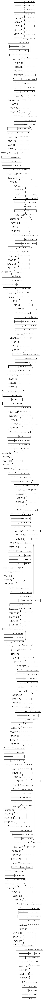

In [ ]:
# Imagen del modelo con Ajuste
plot_model(EfficientNetB0_custom_model, to_file='EfficientNetB0_custom_model.png', show_shapes=True, show_layer_names=True)

In [ ]:
# Tensor Board
tensorboardEfficientNetB0= TensorBoard(log_dir='logs/EfficientNetB0')
lr_reduce = ReduceLROnPlateau(monitor='val_accuracy', factor=0.6, patience=8, verbose=1, mode='max', min_lr=5e-5)
checkpoint = ModelCheckpoint('EfficientNetB0_finetune.h5', monitor= 'val_accuracy', mode= 'max', save_best_only = True, verbose= 1)
earlystopper = EarlyStopping(monitor = 'val_loss', min_delta = 0, patience = 10, verbose = 1, restore_best_weights = True)

# Compilacion y configuracion de hiperparametros
lr= 5e-5
EfficientNetB0_custom_model.compile(loss="categorical_crossentropy", optimizer=Adagrad(learning_rate=lr), metrics=["accuracy"])

In [ ]:
# Entrenamiento
historyEfficientNetB0 = EfficientNetB0_custom_model.fit(x_train, y_train, epochs = 10, batch_size = 32, validation_data=(x_val, y_val),callbacks=[lr_reduce, checkpoint, earlystopper, tensorboardEfficientNetB0], verbose = 1)

# Evaluacion
# Testing
EfficientNetB0score_test = EfficientNetB0_custom_model.evaluate(x_test, y_test,verbose=0)
print("Test loss:", EfficientNetB0score_test[0])
print("Test accuracy:", EfficientNetB0score_test[1])
# Validation
EfficientNetB0score_val = EfficientNetB0_custom_model.evaluate(x_val, y_val, verbose=0)
print("validation loss:", round(EfficientNetB0score_val[0],3))
print("validation accuracy:", round(EfficientNetB0score_val[1],3))

In [ ]:
# Grafico
accuracy = historyEfficientNetB0.history['accuracy']
val_accuracy = historyEfficientNetB0.history['val_accuracy']
loss = historyEfficientNetB0.history['loss']
val_loss = historyEfficientNetB0.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

In [ ]:
# Matriz de confusion
target_names = ['0', '1']
pred = EfficientNetB0_custom_model.predict(x_test, verbose=1)
pred = np.argmax(pred, axis = 1) 
cm = confusion_matrix(np.argmax(y_test, axis=1), pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = [0,1])
fig, ax = plt.subplots(figsize=(10, 10))
disp = disp.plot(ax=ax,cmap=plt.cm.Blues)
plt.show()

In [ ]:
# Reporte
reporteEfficientNetB0 = classification_report(np.argmax(y_test, axis=1), pred, target_names=target_names)
print(reporteEfficientNetB0)

#### ResNet 50

In [ ]:
# Carga y configuracion del modelo
Resnet50_model = ResNet50(weights='imagenet', include_top=False, input_shape=(150, 150, 3))

# Summary
Resnet50_model.summary()

# Imagen del modelo sin Ajuste
#plot_model(Resnet50_model, to_file='Resnet50_model.png', show_shapes=True, show_layer_names=True)

94781440/94765736 [==============================] - 1s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 156, 156, 3)  0           ['input_6[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 75, 75, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalizat

In [ ]:
# Ajuste Fino
for layer in Resnet50_model.layers[:143]:
    layer.trainable = False
for i, layer in enumerate(Resnet50_model.layers):
    print(i, layer.name, layer.trainable)

x = Resnet50_model.output
x = Flatten()(x)
x = BatchNormalization()(x)
predictions = Dense(2, activation='softmax')(x)

Resnet50_custom_model = Model(Resnet50_model.input, predictions)

0 input_6 False
1 conv1_pad False
2 conv1_conv False
3 conv1_bn False
4 conv1_relu False
5 pool1_pad False
6 pool1_pool False
7 conv2_block1_1_conv False
8 conv2_block1_1_bn False
9 conv2_block1_1_relu False
10 conv2_block1_2_conv False
11 conv2_block1_2_bn False
12 conv2_block1_2_relu False
13 conv2_block1_0_conv False
14 conv2_block1_3_conv False
15 conv2_block1_0_bn False
16 conv2_block1_3_bn False
17 conv2_block1_add False
18 conv2_block1_out False
19 conv2_block2_1_conv False
20 conv2_block2_1_bn False
21 conv2_block2_1_relu False
22 conv2_block2_2_conv False
23 conv2_block2_2_bn False
24 conv2_block2_2_relu False
25 conv2_block2_3_conv False
26 conv2_block2_3_bn False
27 conv2_block2_add False
28 conv2_block2_out False
29 conv2_block3_1_conv False
30 conv2_block3_1_bn False
31 conv2_block3_1_relu False
32 conv2_block3_2_conv False
33 conv2_block3_2_bn False
34 conv2_block3_2_relu False
35 conv2_block3_3_conv False
36 conv2_block3_3_bn False
37 conv2_block3_add False
38 conv2_bloc

In [ ]:
# Imagen del modelo con Ajuste
plot_model(Resnet50_custom_model, to_file='Resnet50_custom_model.png', show_shapes=True, show_layer_names=True)

In [ ]:
# Tensor Board
tensorboardResnet50= TensorBoard(log_dir='logs/Resnet50')
lr_reduce = ReduceLROnPlateau(monitor='val_accuracy', factor=0.6, patience=8, verbose=1, mode='max', min_lr=5e-5)
checkpoint = ModelCheckpoint('Resnet50_finetune.h5', monitor= 'val_accuracy', mode= 'max', save_best_only = True, verbose= 1)
earlystopper = EarlyStopping(monitor = 'val_loss', min_delta = 0, patience = 10, verbose = 1, restore_best_weights = True)

# Compilacion y configuracion de hiperparametros
lr= 5e-5
Resnet50_custom_model.compile(loss="categorical_crossentropy", optimizer=Adam(learning_rate=lr), metrics=["accuracy"])

In [ ]:
# Entrenamiento
historyResnet50 = Resnet50_custom_model.fit(x_train, y_train, epochs = 10, batch_size = 32, validation_data=(x_val, y_val),callbacks=[lr_reduce, checkpoint, earlystopper, tensorboardResnet50], verbose = 1)

# Evaluacion
# Testing
Resnet50score_test = Resnet50_custom_model.evaluate(x_test, y_test,verbose=0)
print("Test loss:", Resnet50score_test[0])
print("Test accuracy:", Resnet50score_test[1])
# Validation
Resnet50score_val = Resnet50_custom_model.evaluate(x_val, y_val, verbose=0)
print("validation loss:", round(Resnet50score_val[0],3))
print("validation accuracy:", round(Resnet50score_val[1],3))

In [ ]:
# Grafico
accuracy = historyResnet50.history['accuracy']
val_accuracy = historyResnet50.history['val_accuracy']
loss = historyResnet50.history['loss']
val_loss = historyResnet50.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

In [ ]:
# Matriz de confusion
target_names = ['0', '1']
pred = Resnet50_custom_model.predict(x_test, verbose=1)
pred = np.argmax(pred, axis = 1) 
cm = confusion_matrix(np.argmax(y_test, axis=1), pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = [0,1])
fig, ax = plt.subplots(figsize=(10, 10))
disp = disp.plot(ax=ax,cmap=plt.cm.Blues)
plt.show()

In [ ]:
# Reporte
reporteResnet50 = classification_report(np.argmax(y_test, axis=1), pred, target_names=target_names)
print(reporteResnet50)

#### Ensamble

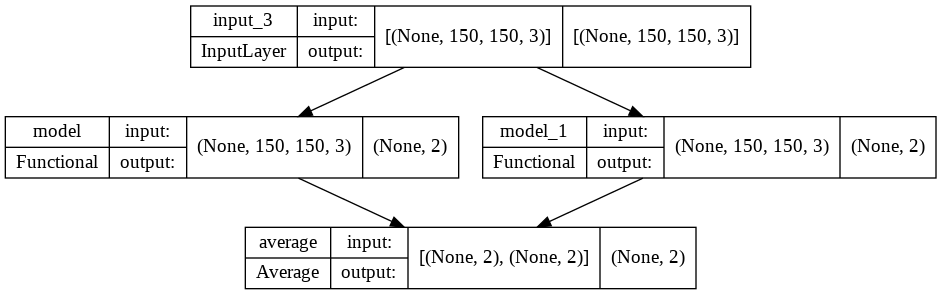

In [11]:
models = [Xception_custom_model, InceptionResNetV2_custom_model]

model_input = Input(shape=(150, 150, 3))
model_outputs = [model(model_input) for model in models]
ensemble_output = Average()(model_outputs)
ensemble_model = Model(inputs=model_input, outputs=ensemble_output, name='ensamble1')
plot_model(ensemble_model, to_file='model4_plot.png', show_shapes=True, show_layer_names=True)

In [12]:
# Tensor Board
tensorboardEnsemble= TensorBoard(log_dir='logs/Ensemble')
lr_reduce = ReduceLROnPlateau(monitor='val_accuracy', factor=0.6, patience=8, verbose=1, mode='max', min_lr=5e-5)
checkpoint = ModelCheckpoint('Ensemble_finetune.h5', monitor= 'val_accuracy', mode= 'max', save_best_only = True, verbose= 1)
earlystopper = EarlyStopping(monitor = 'val_loss', min_delta = 0, patience = 10, verbose = 1, restore_best_weights = True)

# Compilacion y configuracion de hiperparametros
lr= 5e-5
ensemble_model.compile(loss="categorical_crossentropy", optimizer=Adam(learning_rate=lr), metrics=["accuracy"])

In [13]:
# Entrenamiento
historyEnsemble = ensemble_model.fit(x_train, y_train, epochs = 10, batch_size = 32, validation_data=(x_val, y_val),callbacks=[lr_reduce, checkpoint, earlystopper, tensorboardEnsemble], verbose = 1)

# Evaluacion
# Testing
Ensemblescore_test = ensemble_model.evaluate(x_test, y_test,verbose=0)
print("Test loss:", Ensemblescore_test[0])
print("Test accuracy:", Ensemblescore_test[1])
# Validation
Ensemblescore_val = ensemble_model.evaluate(x_val, y_val, verbose=0)
print("validation loss:", round(Ensemblescore_val[0],3))
print("validation accuracy:", round(Ensemblescore_val[1],3))

Epoch 1/10
75/75 [==============================] - ETA: 0s - loss: 0.2074 - accuracy: 0.9233
Epoch 1: val_accuracy improved from -inf to 0.96125, saving model to Ensemble_finetune.h5
75/75 [==============================] - 50s 330ms/step - loss: 0.2074 - accuracy: 0.9233 - val_loss: 0.0882 - val_accuracy: 0.9613 - lr: 5.0000e-05
Epoch 2/10
75/75 [==============================] - ETA: 0s - loss: 0.0922 - accuracy: 0.9721
Epoch 2: val_accuracy did not improve from 0.96125
75/75 [==============================] - 18s 234ms/step - loss: 0.0922 - accuracy: 0.9721 - val_loss: 0.0856 - val_accuracy: 0.9538 - lr: 5.0000e-05
Epoch 3/10
75/75 [==============================] - ETA: 0s - loss: 0.0627 - accuracy: 0.9842
Epoch 3: val_accuracy did not improve from 0.96125
75/75 [==============================] - 16s 215ms/step - loss: 0.0627 - accuracy: 0.9842 - val_loss: 0.0806 - val_accuracy: 0.9575 - lr: 5.0000e-05
Epoch 4/10
75/75 [==============================] - ETA: 0s - loss: 0.0362 - ac

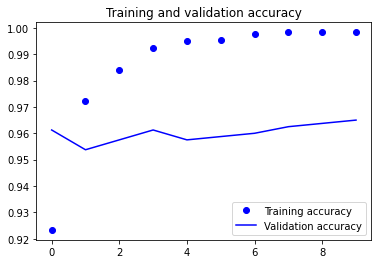

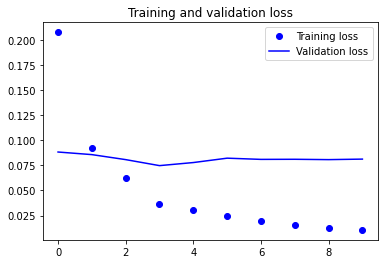

In [14]:
# Grafico
accuracy = historyEnsemble.history['accuracy']
val_accuracy = historyEnsemble.history['val_accuracy']
loss = historyEnsemble.history['loss']
val_loss = historyEnsemble.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

25/25 [==============================] - 7s 126ms/step


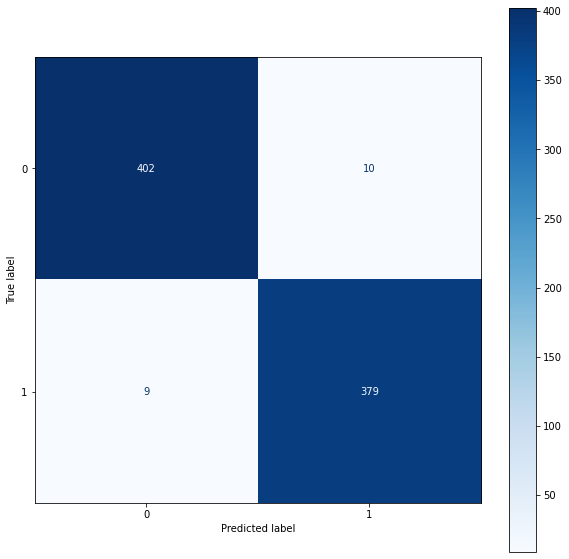

In [15]:
# Matriz de confusion
target_names = ['0', '1']
pred = ensemble_model.predict(x_test, verbose=1)
pred = np.argmax(pred, axis = 1) 
cm = confusion_matrix(np.argmax(y_test, axis=1), pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels = [0,1])
fig, ax = plt.subplots(figsize=(10, 10))
disp = disp.plot(ax=ax,cmap=plt.cm.Blues)
plt.show()

In [16]:
# Reporte
reporte_ensemble_model = classification_report(np.argmax(y_test, axis=1), pred, target_names=target_names)
print(reporte_ensemble_model)

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       412
           1       0.97      0.98      0.98       388

    accuracy                           0.98       800
   macro avg       0.98      0.98      0.98       800
weighted avg       0.98      0.98      0.98       800



### Tensor Board

In [17]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

### Referencias

- https://data-flair.training/blogs/cats-dogs-classification-deep-learning-project-beginners/
- https://keras.io/api/applications/inceptionresnetv2/
- https://www.kaggle.com/abnera/transfer-learning-keras-xception-cnn
- https://keras.io/guides/transfer_learning/
- https://machinelearningmastery.com/how-to-use-transfer-learning-when-developing-convolutional-neural-network-models/
- https://keras.io/api/applications/efficientnet/#efficientnetb7-function 
- http://personal.cimat.mx:8181/~mrivera/cursos/aprendizaje_profundo/preentrenadas/preentrenadas.html
- https://keras.io/api/applications/inceptionresnetv2/
- https://neptune.ai/blog/transfer-learning-guide-examples-for-images-and-text-in-keras
- https://keras.io/api/applications/
- https://analyticsindiamag.com/a-comparison-of-4-popular-transfer-learning-models/
- https://stackabuse.com/image-classification-with-transfer-learning-in-keras-create-cutting-edge-cnn-models/
- https://colab.research.google.com/github/tensorflow/tensorboard/blob/master/docs/tensorboard_in_notebooks.ipynb#scrollTo=lpUO9HqUKP6z
- https://keras.io/api/optimizers/
- Zhuang, F., Qi, Z., Duan, K., Xi, D., Zhu, Y., Zhu, H., ... & He, Q. (2020). A comprehensive survey on transfer learning. Proceedings of the IEEE, 109(1), 43-76.